# Analysis of Xenium ( considering non-expanded cells)

This script shows how to analyze a typical Xenium segmented dataset. The analysis is based on Scanpy (documentation in  https://scanpy.readthedocs.io/en/stable/index.html) and Squidpy (documentation in https://squidpy.readthedocs.io/en/stable/)

## Loading the packages

We import the packages needed for it. If something fails, means that we haven't installed something in the environment

In [62]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
import xb.plotting as xp
import xb.formatting as xf

# Load the functions

## Importing the data and creating an anndata object

In this case we aim to keep just the nuclear information.That's why 

In [63]:
adata1=sc.read(r"../../data/unprocessed_adata/h_breast_2.h5ad")

In [64]:
adata1new=xf.keep_nuclei(adata1)
adata1=adata1new[:,adata1new.var['in_panel']]

/mnt/d/Xenium_benchmarking-main/Xenium_benchmarking-main/xb/formatting.py:120: FutureWarning: X.dtype being converted to np.float32 from int64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata1nuc=sc.AnnData(np.array(ct1),obs=adataobs,var=adata1.var)
/home/sergioms/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


The object where our data is contained is called anndata (documentation in https://anndata.readthedocs.io/en/latest/). The expression is stored in adata.X. The metadata is stored in adata.obs. The data associated with the genes is stored in adata.var

In [65]:
adata.obs

,index,ind,cell_id,x_centroid,y_centroid,transcript_counts,control_probe_counts,control_codeword_counts,total_counts,cell_area,nucleus_area,n_counts,leiden_2_2,leiden_1_8,leiden_1_4,leiden_1_0,leiden_0_8,leiden_0_6,projected_class,projected_annotation
0,1,2,2,823.183350,57.322746,73,0,0,35.0,184.824531,16.798125,35.0,7,6,6,5,5,5,macrophages,5_macrophages
1,2,3,3,835.742249,60.938423,151,0,0,76.0,146.351406,25.377813,76.0,0,1,1,2,4,4,smooth muscle,0_smooth muscle
2,3,4,4,845.734009,65.249466,125,0,0,69.0,156.330938,24.158594,69.0,9,8,5,3,2,2,smooth muscle,0_smooth muscle
3,4,5,5,833.372620,70.787758,121,0,0,61.0,175.115938,27.816250,61.0,9,8,5,3,2,2,grandular,9_grandular
4,5,6,6,822.615906,73.363060,54,0,0,42.0,66.334531,15.985312,42.0,0,1,1,2,4,4,grandular,17_grandular
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35836,37082,37316,37316,3392.504639,2679.046875,93,0,0,37.0,411.057344,22.442656,37.0,1,2,4,4,6,6,adipocytes,3_adipocytes
35837,37083,37317,37317,3442.737549,2667.384277,39,0,0,30.0,257.119687,15.849844,30.0,24,6,6,5,5,5,macrophages,5_macrophages
35838,37084,37318,37318,3453.798828,2683.199463,46,0,0,33.0,163.239844,15.082187,33.0,1,2,4,4,6,6,adipocytes,3_adipocytes
35839,37085,37319,37319,3337.515625,2683.341553,56,0,0,36.0,423.972031,15.262813,36.0,24,6,6,5,5,5,macrophages,33_macrophages


Define folder where we'll save all outputs and create it if it didn't exist

In [66]:
output_folder='celltype_identification_hbreast_dcis_nuclei'

In [67]:
import os
if  not os.path.exists('../../figures/'+output_folder):
    os.mkdir('../../figures/'+output_folder)

 We calculate the total number of reads in each cell and store it in 'total_counts'.We keep cells with more than X reads and less than Y reads

/home/sergioms/.local/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


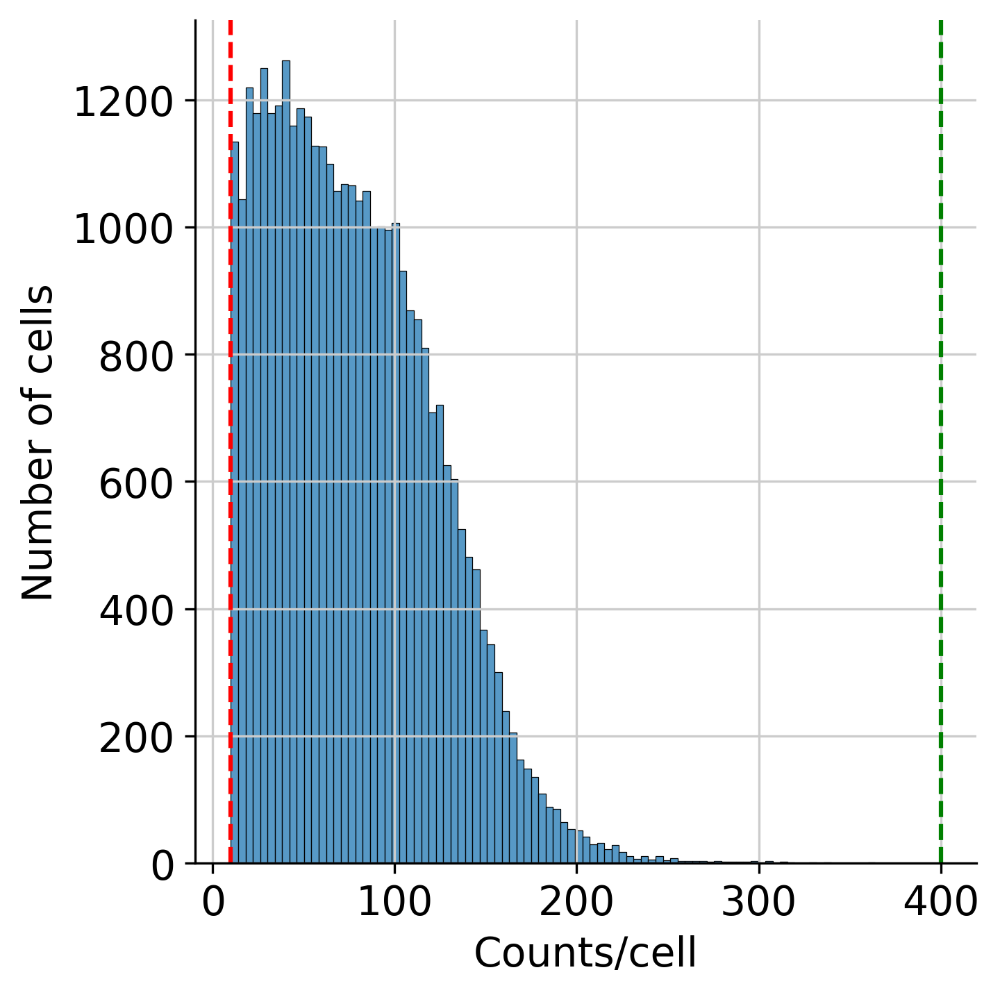

In [70]:
maximum_number_of_reads=400
minimum_number_of_reads=10
adata1.obs=adata1.obs.reset_index()
adata1.obs['total_counts']=list(np.sum(adata1.X,axis=1))
sns.displot(adata1.obs,x='total_counts')
plt.xlabel('Counts/cell')
plt.ylabel('Number of cells')
plt.axvline(x=maximum_number_of_reads,color='green',linestyle='--')
plt.axvline(x=minimum_number_of_reads,color='red',linestyle='--')
sc.pp.filter_cells(adata1,min_counts=minimum_number_of_reads)
sc.pp.filter_cells(adata1,max_counts=maximum_number_of_reads)
plt.savefig('../../figures/'+output_folder+'/countsxcell_histogram.pdf')

In [71]:
adata=adata1

# Normalization of the data

We now save the raw data in adata.raw and apply normalization and log-transformation to minimize the effect of outliers. We also scale the data to give the same importance to all genes in clustering

In [72]:
adata.raw=adata
adata.layers['raw']=adata.X
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

[OPTIONAL] After normalizing and logmarizing, the data we CAN, if we wish, filter only highly variable genes for clustering. This step is key in the analysis of single cell RNA sequencing datasets (with +20.000 genes) but it's not that useful in targeted methods such as ISS. However, it can help to keep variables only for clustering

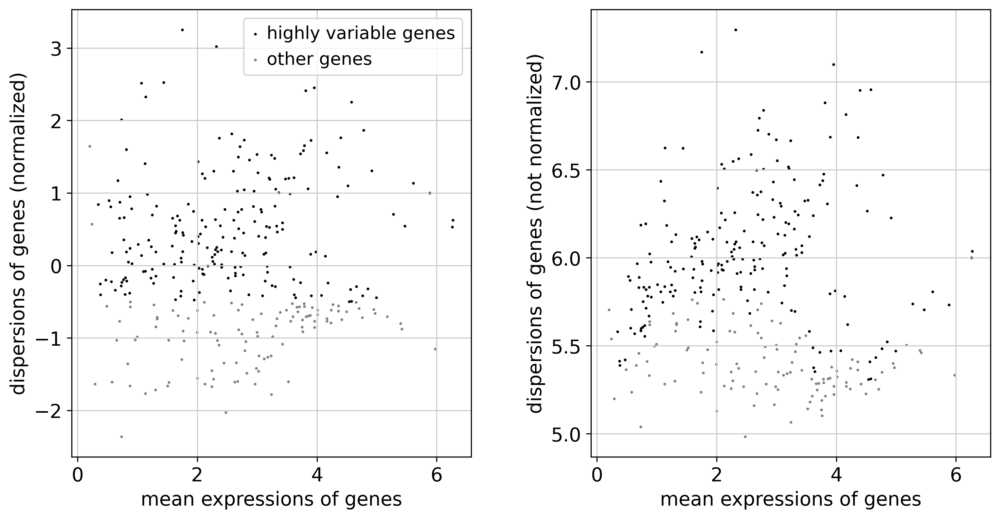

In [73]:
plt.rcParams['figure.facecolor'] = 'white'
sc.pp.highly_variable_genes(adata, min_mean=0.3, max_mean=7, min_disp=-0.5)
sc.pl.highly_variable_genes(adata)
#adata=adata[:,adata.var.highly_variable==True]

[OPTIONAL] We can also scale the data. This means that we scale the expression of every gene between 0 and 1. This will give decrease the impact of highly expressed genes and will increase the importance of lowly expressed genes

In [74]:
#let's not scale in this case
sc.pp.scale(adata,max_value=100)

# Dimensional reduction and clustering

We apply principal component analysis to find the appropiate nubmer of components to use to perform dimensionality reduction and clustering

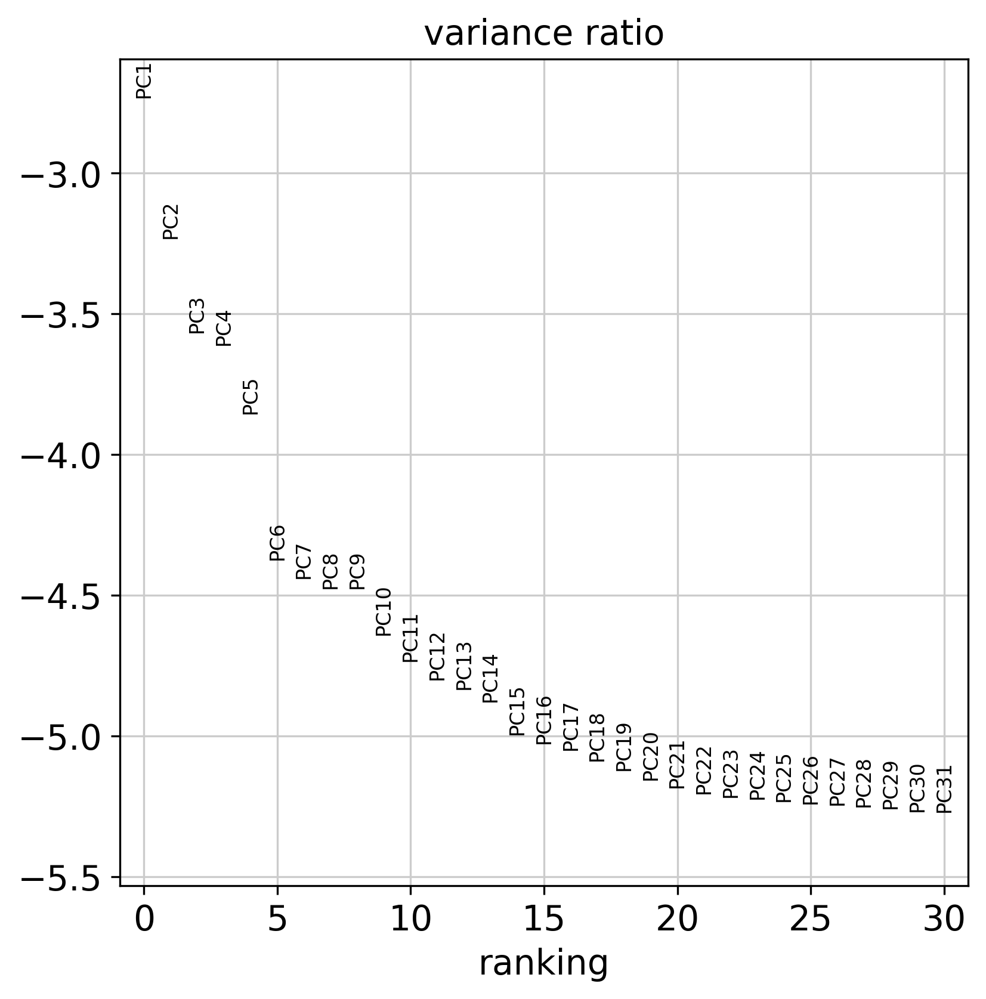

In [75]:
sc.tl.pca(adata, svd_solver='arpack')
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.pca_variance_ratio(adata, log=True)

We select to go with the top X first principal components to look for the nearest neighbors. We are going to represent our data using graph-based methods, like UMAP. For this, we first need to create a graph by linking each cell to the n closest neighbors (n_neighbors) in the dataset. We can select the numbers of principal components to use

In [76]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=20)

We can, then, run clustering, by calling either leiden or louvain clustering. By changing the parameter "resolution" we will generate more or less clusters. Higher resolution means more clusters. The clusters (groups of cells) are indepent from its visualization, which we will create using UMAP later on

In [77]:
sc.tl.leiden(adata,resolution=2.2,key_added='leiden_2_2')
sc.tl.leiden(adata,resolution=1.8,key_added='leiden_1_8')
sc.tl.leiden(adata,resolution=1.4,key_added='leiden_1_4')
sc.tl.leiden(adata,resolution=1.0,key_added='leiden_1_0')
sc.tl.leiden(adata,resolution=0.8,key_added='leiden_0_8')
sc.tl.leiden(adata,resolution=0.6,key_added='leiden_0_6')

To VISUALIZE the diversity of our cells, We perfrom UMAP. The closest two spots are in UMAP, the more similar they will be. With the comand sc.tl.umap. we CALCULATE the UMAP embedding. With sc.pl.umap will VISUALIZE the UMAP.

In [78]:
sc.tl.umap(adata,min_dist=0.3)

On top of the UMAP you can visualize any variable that you might be interested (a metadata column or gene expression). We need to modify the parameter "color" to visualize the appropiate variable on the UMAP

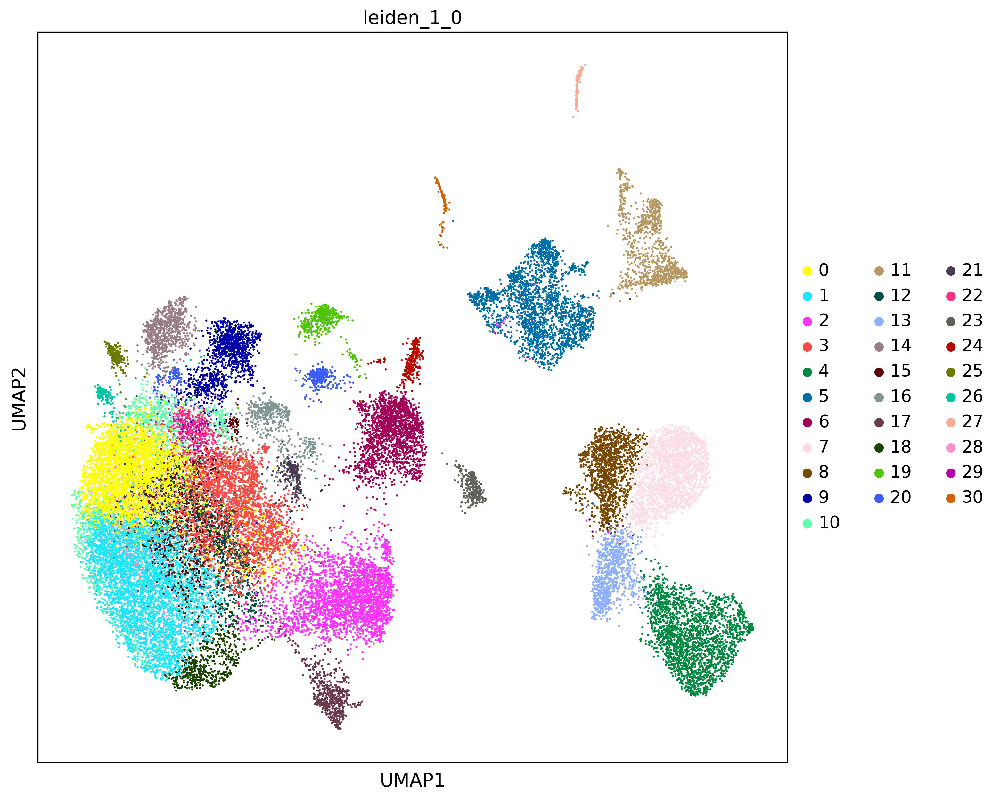

In [90]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,size=10,color=['leiden_1_0'])

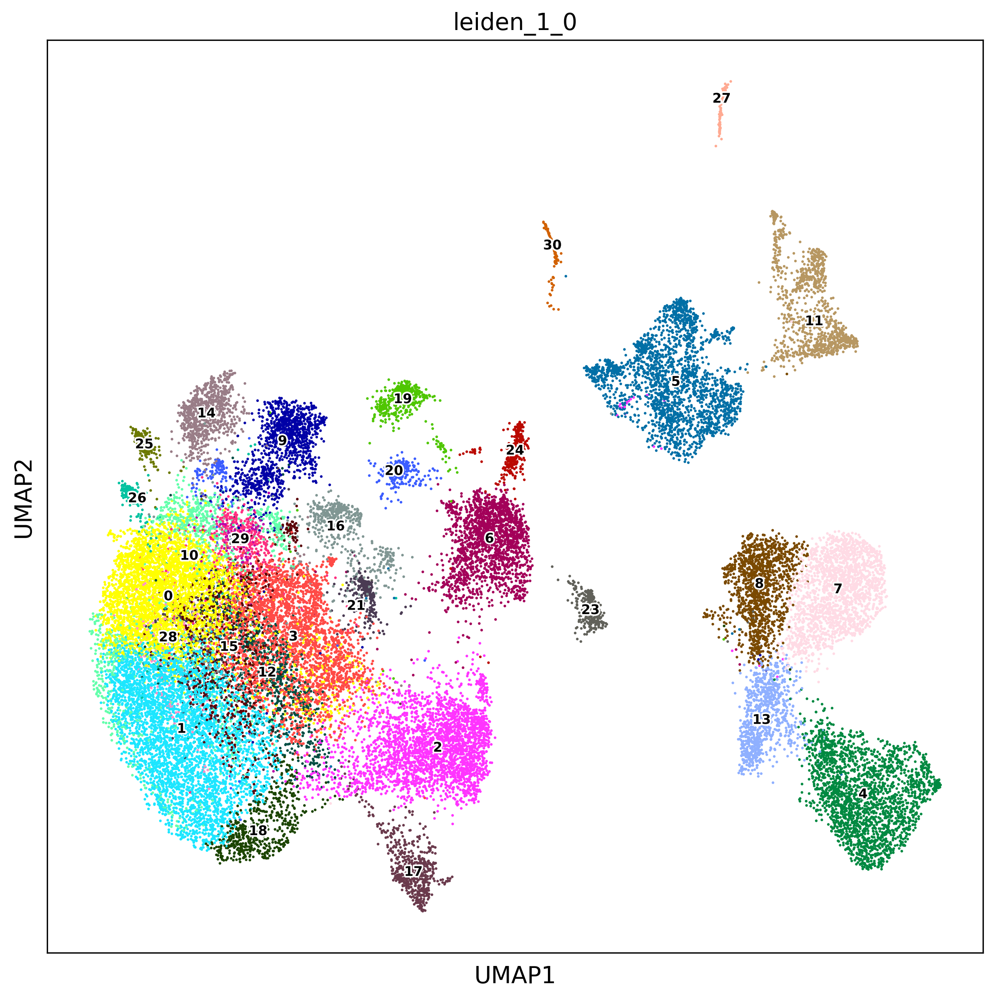

In [79]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(10,10))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,size=10,color=['leiden_1_0'],legend_loc='on data',legend_fontsize=8,legend_fontoutline=2,show=False)
plt.savefig('../../figures/'+output_folder+'/hbreast_dcis_leiden_1_0_ondata.pdf',bbox_inches='tight')

In [80]:
saving_path2=r'../../data/processed_adata'
adata_exp=sc.read(saving_path2+'/adata_hbreast_dcis.h5ad')

In [81]:
transfor_dic=dict(zip(adata_exp.obs['cell_id'],adata_exp.obs['Class']))
transfor_dic2=dict(zip(adata_exp.obs['cell_id'],adata_exp.obs['initial_annotation']))

In [82]:
adata.obs['projected_class']=adata.obs['cell_id'].map(transfor_dic)
adata.obs['projected_annotation']=adata.obs['cell_id'].map(transfor_dic2)

<AxesSubplot:title={'center':'projected_class'}, xlabel='UMAP1', ylabel='UMAP2'>

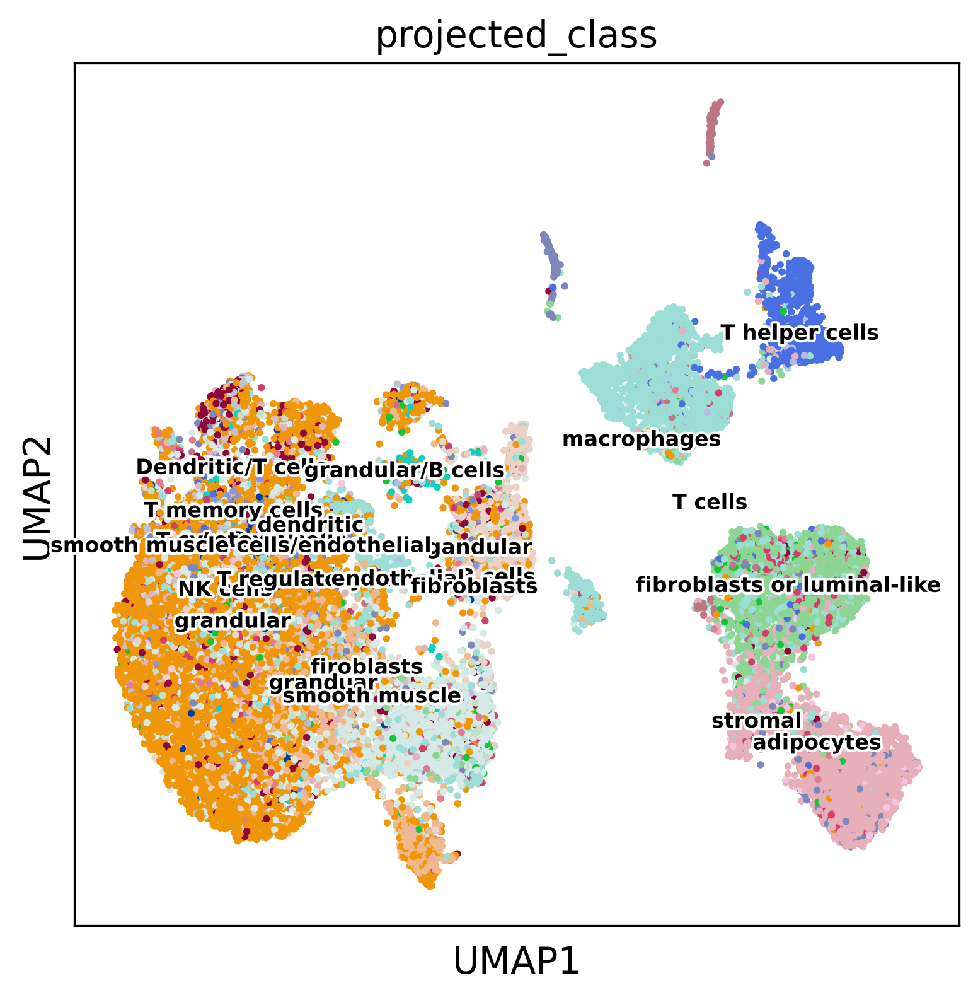

In [93]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(6,6))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,size=30,color=['projected_class'],legend_fontsize=8,legend_fontoutline=2,show=False,legend_loc='on data')

<AxesSubplot:title={'center':'projected_class'}, xlabel='UMAP1', ylabel='UMAP2'>

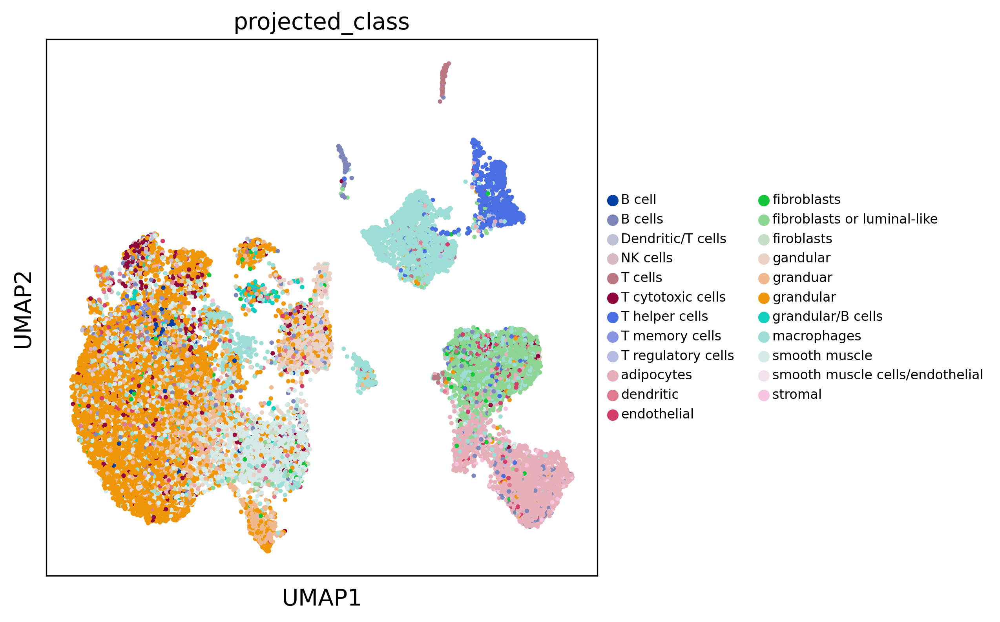

In [83]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(6,6))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,size=30,color=['projected_class'],legend_fontsize=8,legend_fontoutline=2,show=False)

<AxesSubplot:title={'center':'CPA3'}, xlabel='UMAP1', ylabel='UMAP2'>

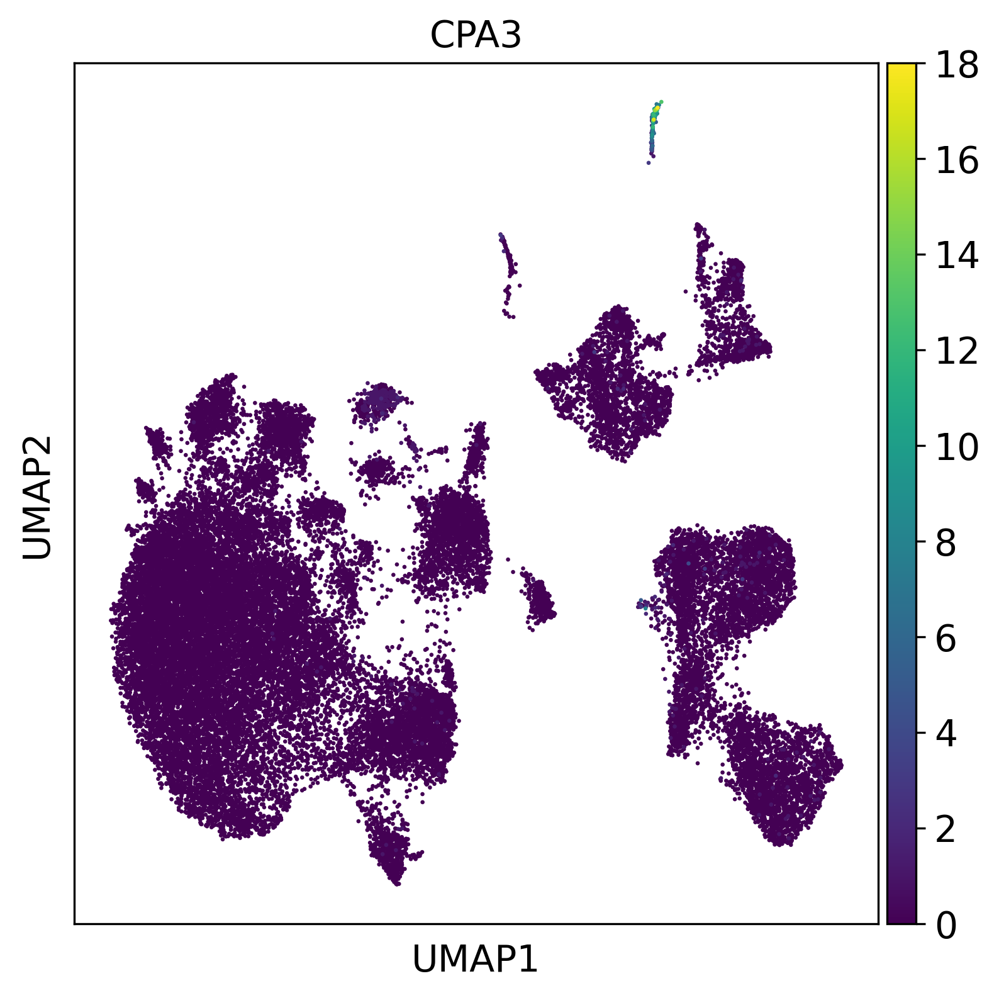

In [94]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(6,6))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,size=10,color=['CPA3'],legend_fontsize=8,legend_fontoutline=2,show=False,use_raw=True)

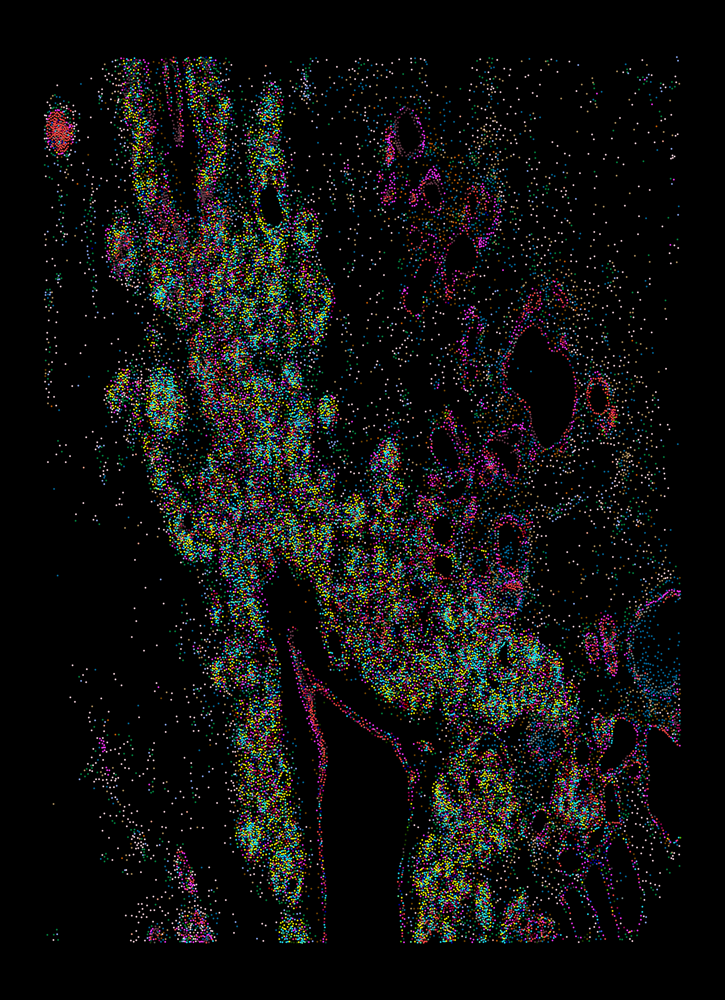

In [92]:
xp.map_of_clusters(adata,key='leiden_1_0',size=1,background='black',clusters='all',figuresize=(7,10),save='../../figures/'+output_folder,format='jpg')

In [86]:
sc.tl.rank_genes_groups(adata, 'leiden_1_0',method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(adata, n_genes=5, sharey=False, key="wilcoxon",fontsize=25,show=False)
plt.savefig('../../figures/'+output_folder+'/original_leiden_3repl_1_0_deg_update.pdf',bbox_inches='tight')

/home/sergioms/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/sergioms/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/sergioms/.local/lib/python3.8/site-packages/scanpy/tools/_rank_genes_groups.py:399: PerformanceWarning: DataFrame is highly fragmente

In [88]:
adata.obs['X']=adata.obs['x_centroid']*4.70588
adata.obs['Y']=adata.obs['y_centroid']*4.70588
import scipy as sp
adata.X = sp.sparse.csr_matrix(adata.X)

In [89]:
saving_path=r'../../data/processed_adata'
adata.write(saving_path+'/adata_hbreast_dcis_nuclei.h5ad')

# Take annotation from expanded and project them on this dataset

In [99]:
anno

,Cluster,Cell type,Top ranked genes
0,0,Cancer,NaN
1,1,Cancer,NaN
2,2,Smooth muscle cells,NaN
3,3,Cancer,NaN
4,4,Cancer,NaN
5,5,Macrophaes,NaN
6,6,Cancer luminal,NaN
7,7,CXCL12 Fibroblast,NaN
8,8,POSTN Fibroblast,NaN
9,9,Cancer,NaN


In [106]:
anno=pd.read_csv('../../data/annotation_dictionaries/number_to_annotation_Breast_Cancer_small_nuclei.csv',sep=';')
num2anno=dict(zip(anno['Cluster '],anno['Cell type']))
#adata_exp=sc.read(saving_path+'/adata_hbreast1.h5ad')
adata.obs['Class']=list(adata.obs['leiden_1_0'].map(num2anno))
adata.obs['initial_annotation']=adata.obs['leiden_1_0'].astype(str)+'_'+adata.obs['Class']

In [107]:
adata.obs['initial_annotation']

0                 5_Macrophaes
1        2_Smooth muscle cells
2                     3_Cancer
3                     3_Cancer
4        2_Smooth muscle cells
                 ...          
35836             4_Adypocytes
35837             5_Macrophaes
35838             4_Adypocytes
35839             5_Macrophaes
35840      7_CXCL12 Fibroblast
Name: initial_annotation, Length: 35841, dtype: object

<AxesSubplot:title={'center':'Class'}, xlabel='UMAP1', ylabel='UMAP2'>

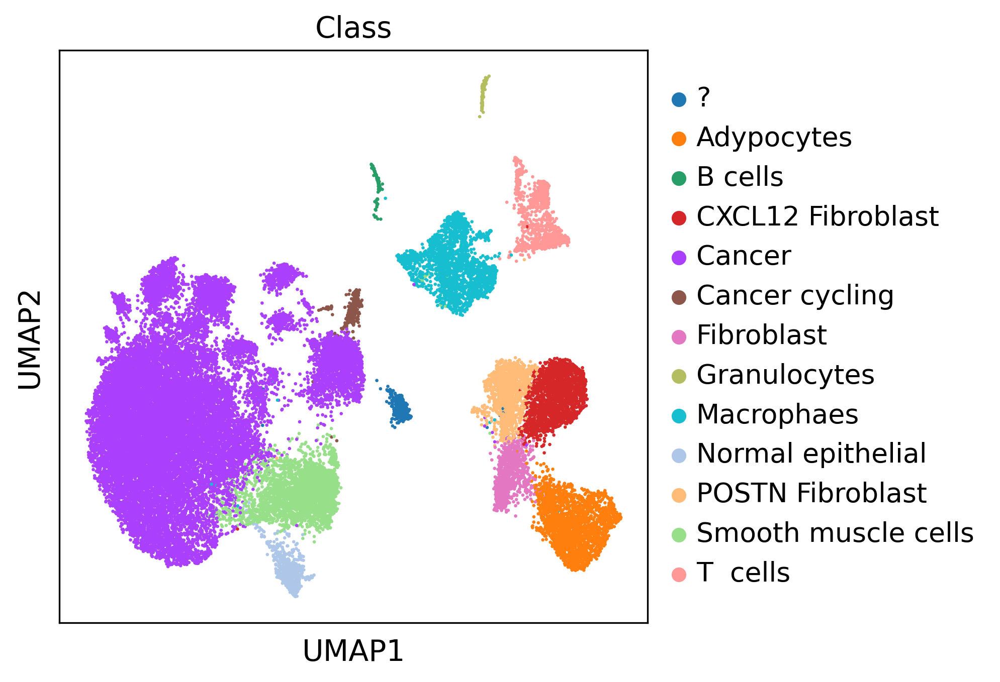

In [108]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(5,5))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['Class'],size=10,show=False)
#plt.savefig('../../figures/'+output_folder+'/DCIS_class_ondata.pdf',bbox_inches='tight')

[<AxesSubplot:title={'center':'MYBPC1'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'ACTA2'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <AxesSubplot:title={'center':'EDN1'}, xlabel='UMAP1', ylabel='UMAP2'>]

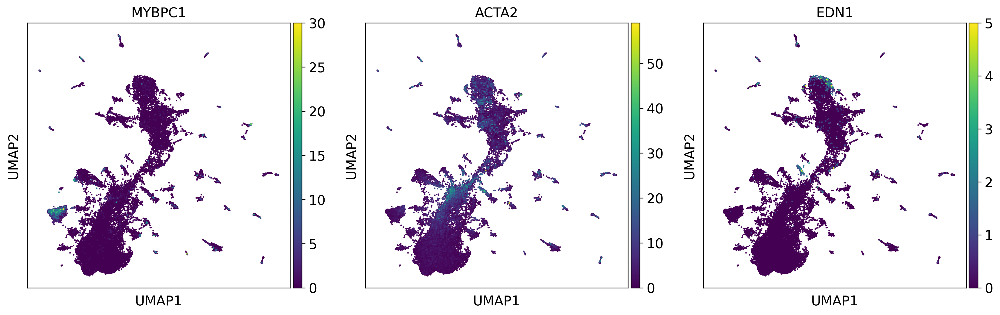

In [49]:
sc.set_figure_params(scanpy=True, dpi=150,figsize=(5,5))
plt.rcParams['figure.facecolor'] = 'white'
sc.pl.umap(adata,color=['MYBPC1','ACTA2','EDN1'],size=10,show=False,use_raw=True)
#plt.savefig('../../figures/'+output_folder+'/DCIS_class_ondata.pdf',bbox_inches='tight')

In [19]:
anno

,Cluster,Cell type,Top ranked genes
0,0,smooth muscle,MYLK/KRT13/ACTA2
1,1,grandular,TACSTD2/GATA3/ANKD30A
2,2,grandular,ESR1/GATA3/FLNB/ANKD30A
3,3,adipocytes,AQP1/PECAM1/CAV1/CD93
4,4,fibroblasts or luminal-like,LUM/CXCL12/MMP2/PDGFRB
5,5,macrophages,FCER1G/AIF1/LYZ/CD4
6,6,gandular,CENPF/TOP2A/GATA3/CCND1
7,7,granduar,SERPINA3/KRT7/PIGR/DSC2
8,8,grandular,PDK4/TACSTD2/ESR1/FLNB
9,9,grandular,MCBPC/MLPH/FOXA1


# Plot additional plots

In [110]:
plotting=['transcript_counts',
       'control_probe_counts', 'control_codeword_counts', 'total_counts',
       'cell_area', 'nucleus_area', 'n_counts', 'leiden_2_2', 'leiden_1_8',
       'leiden_1_4', 'leiden_1_0', 'leiden_0_8', 'leiden_0_6']

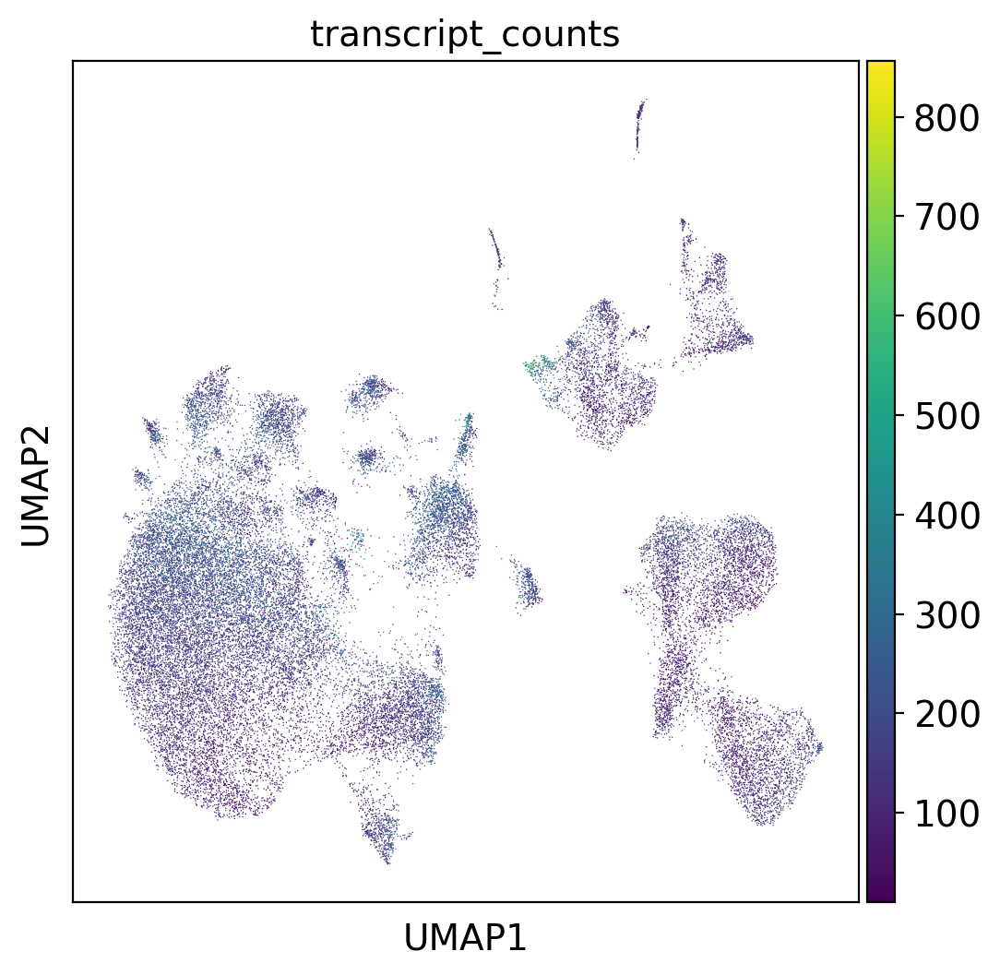

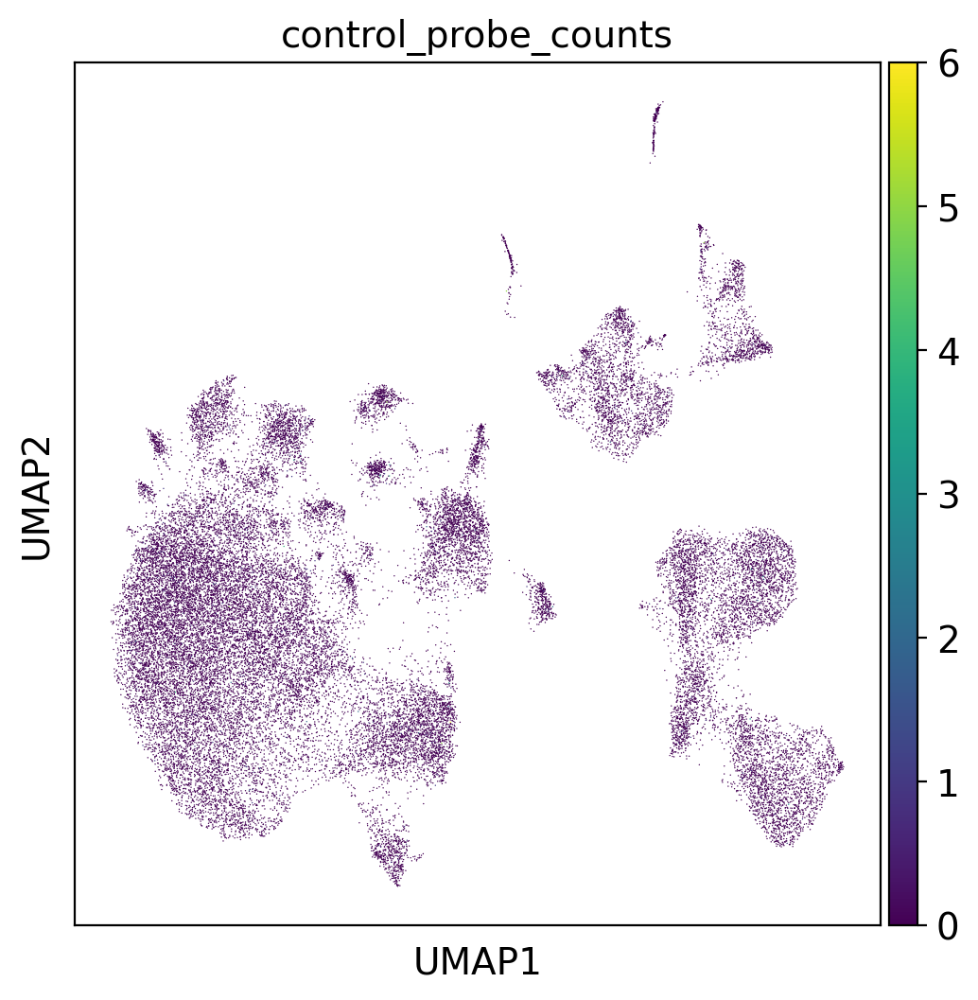

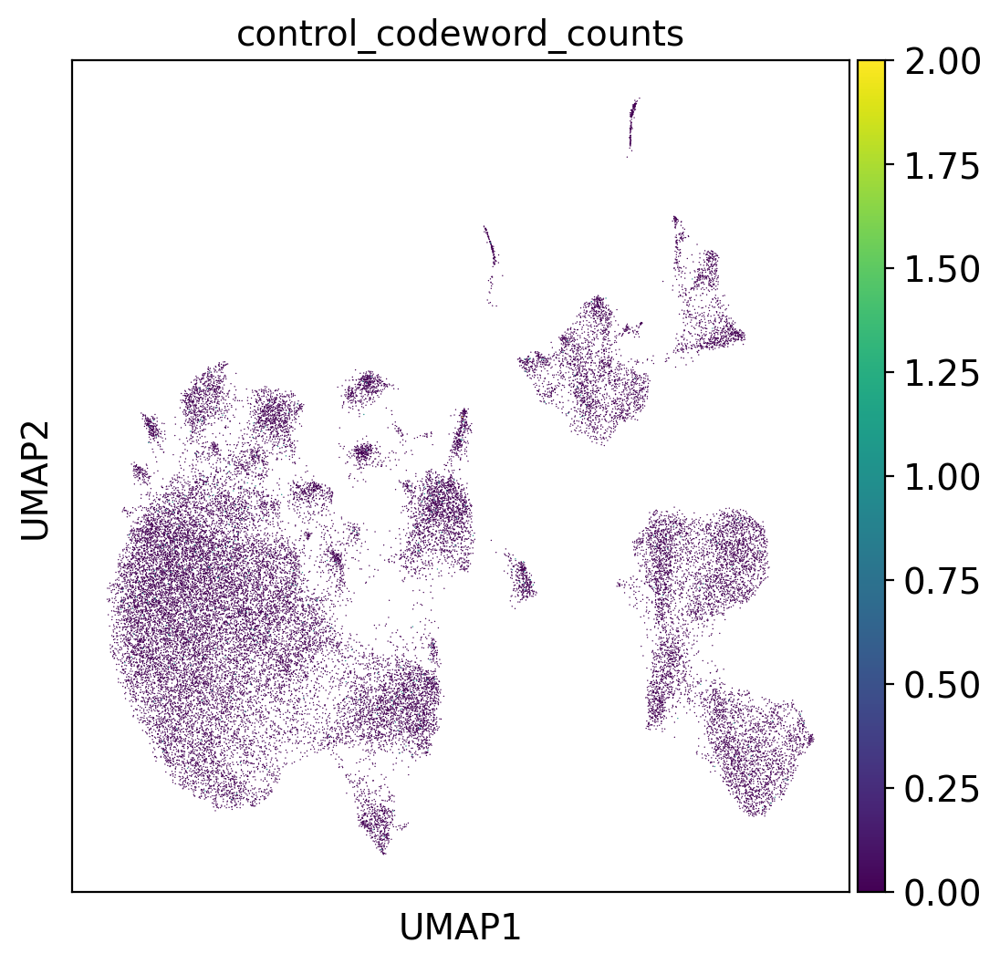

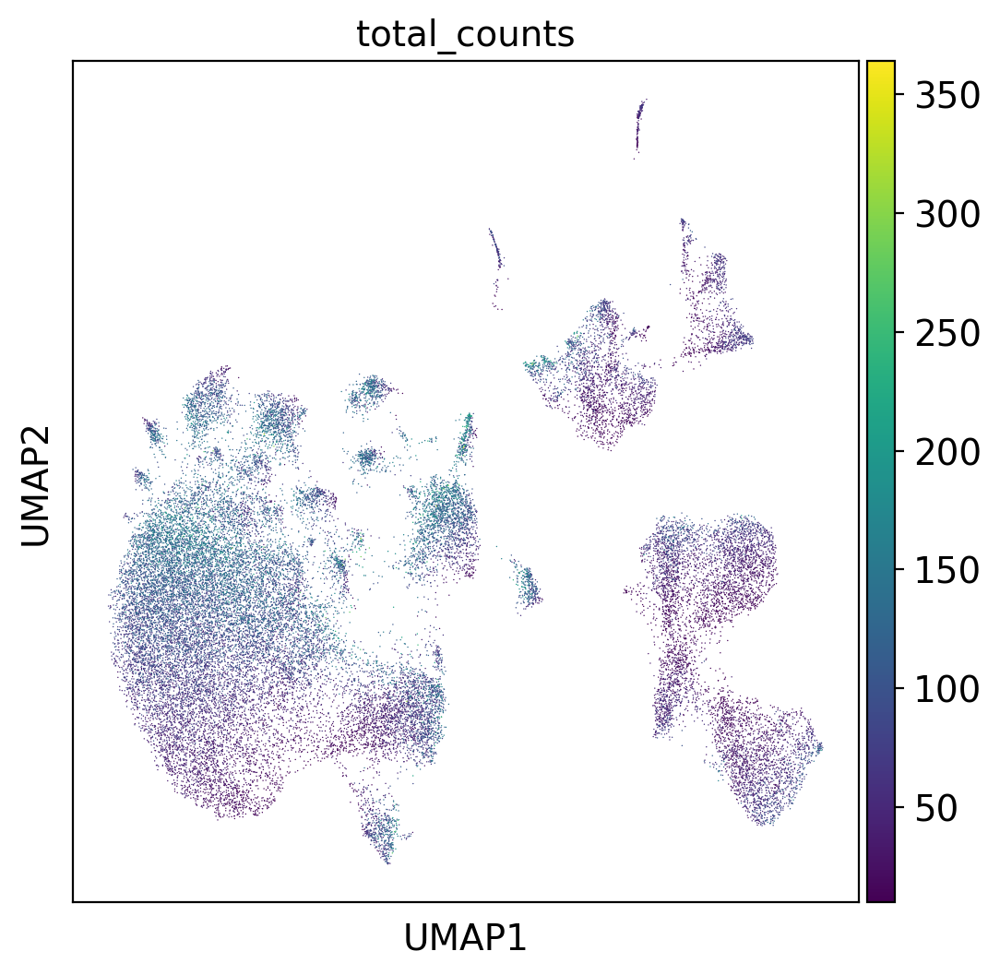

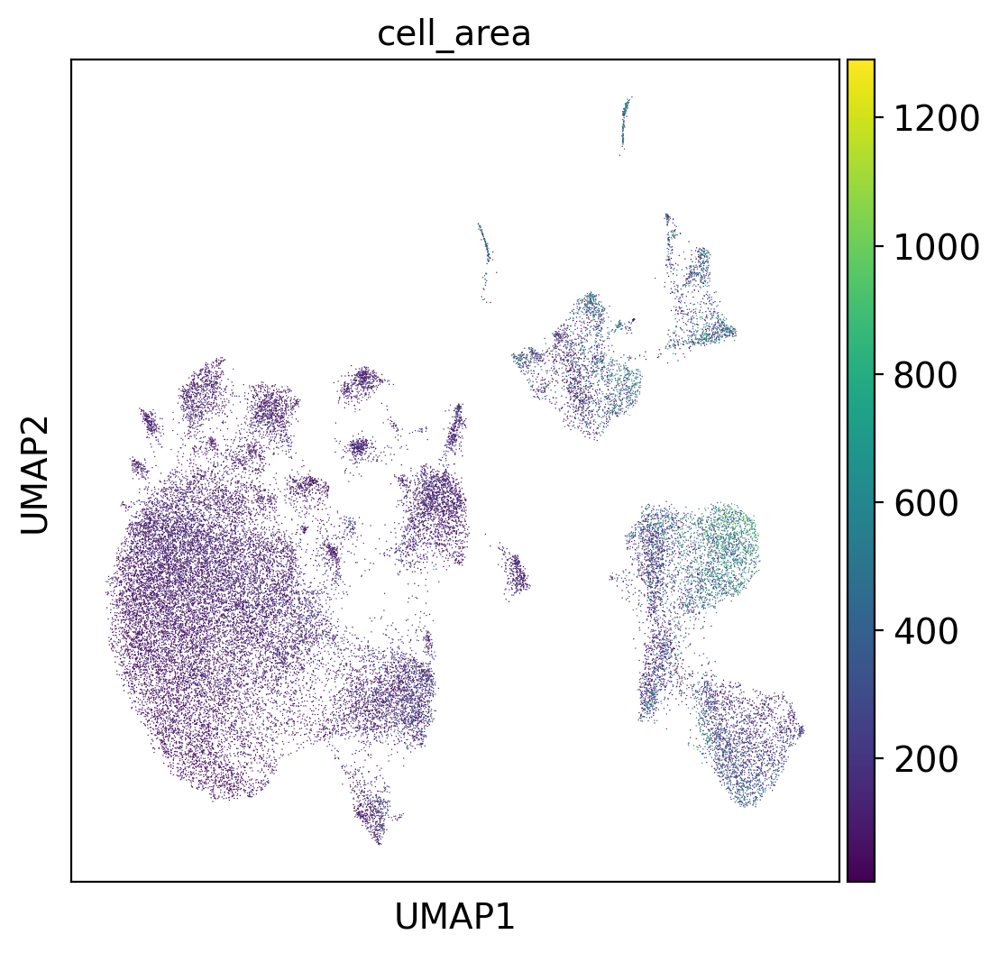

...

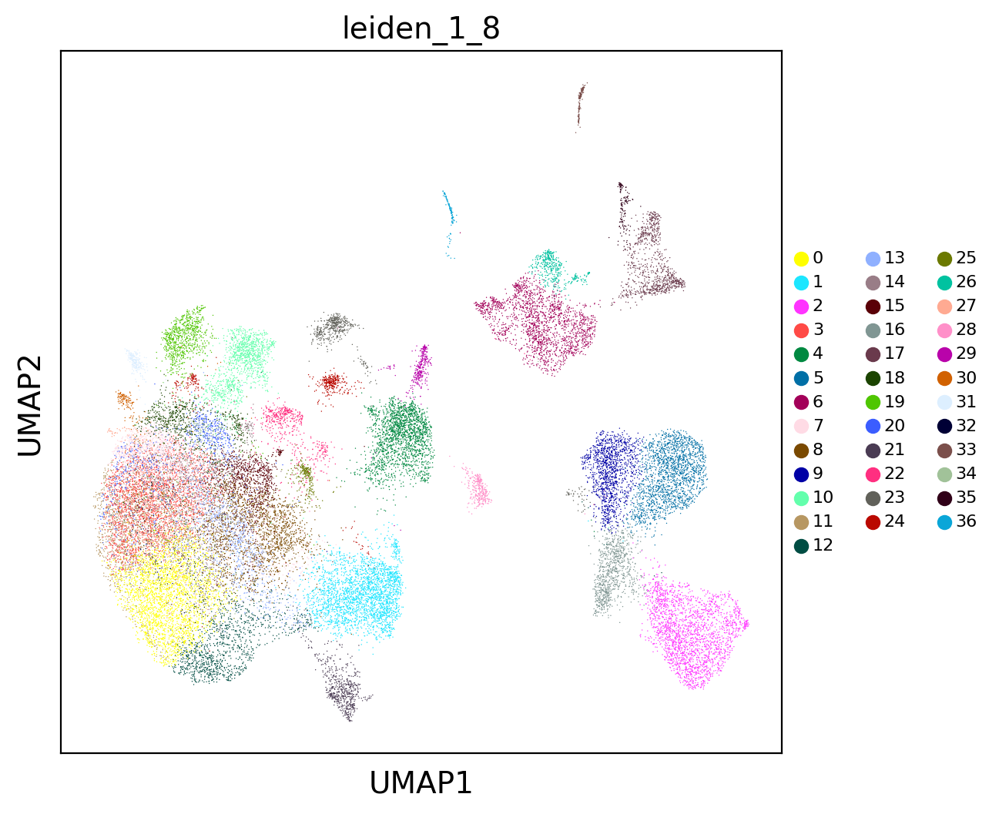

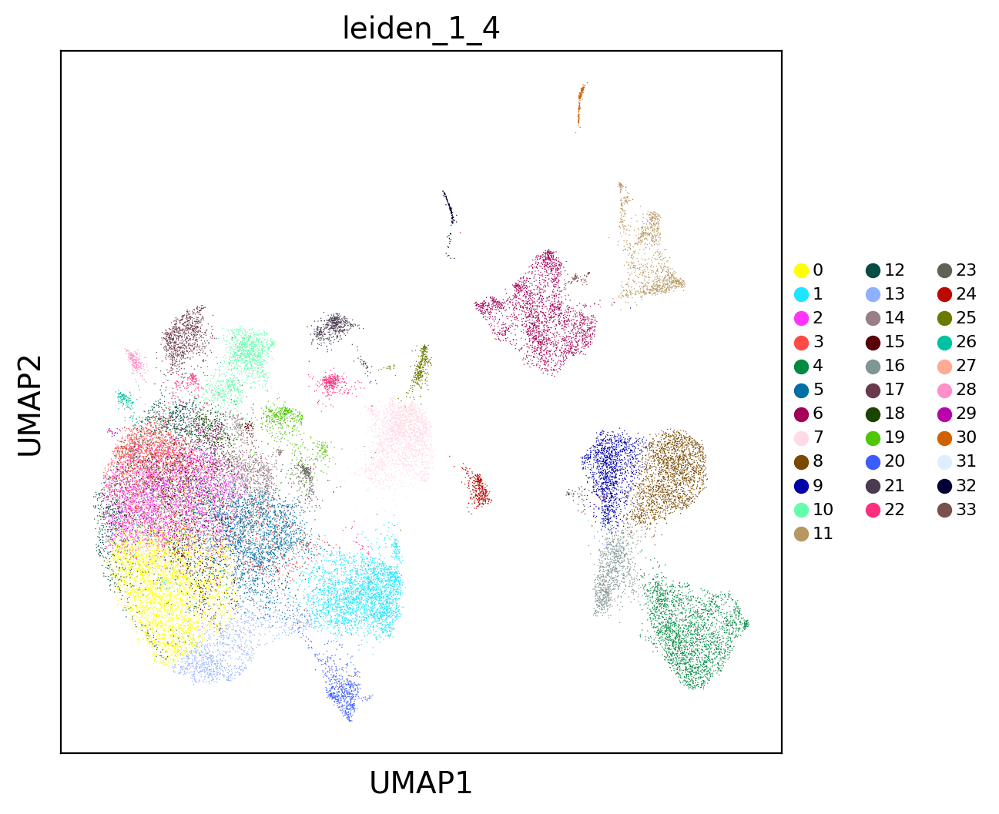

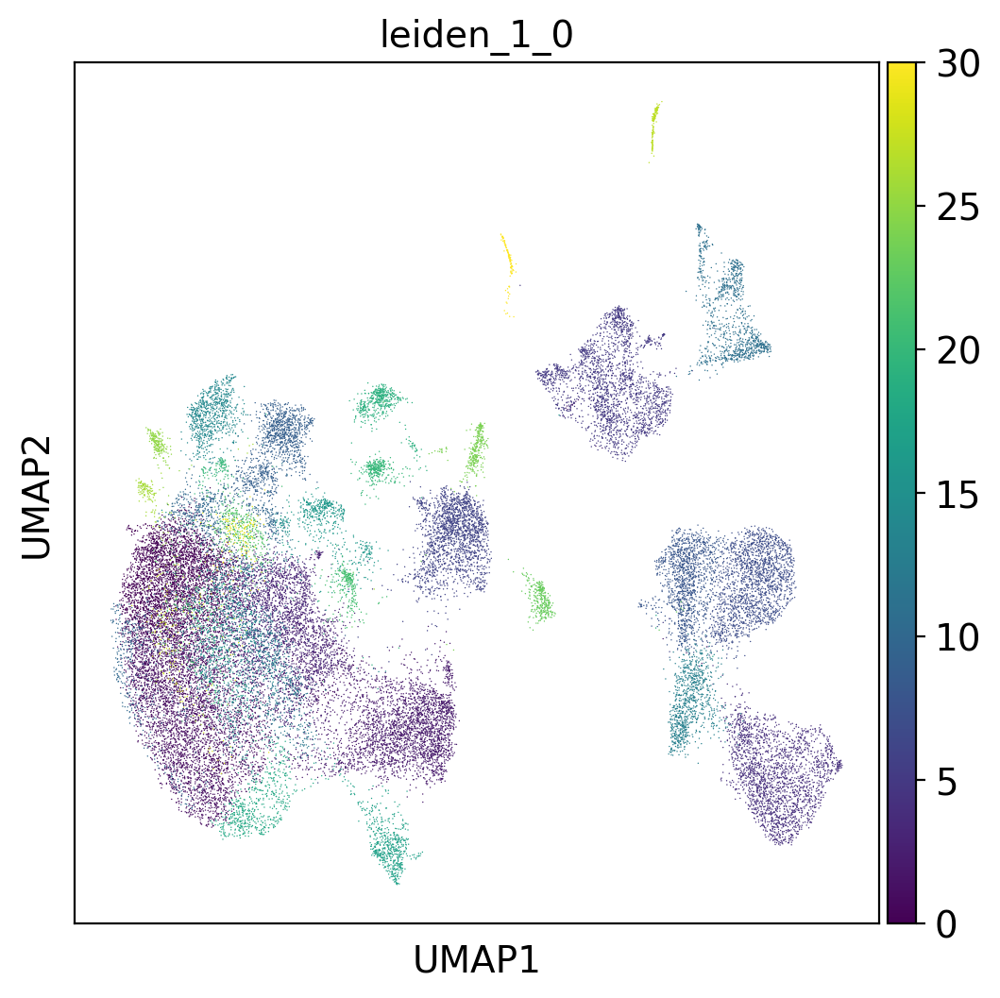

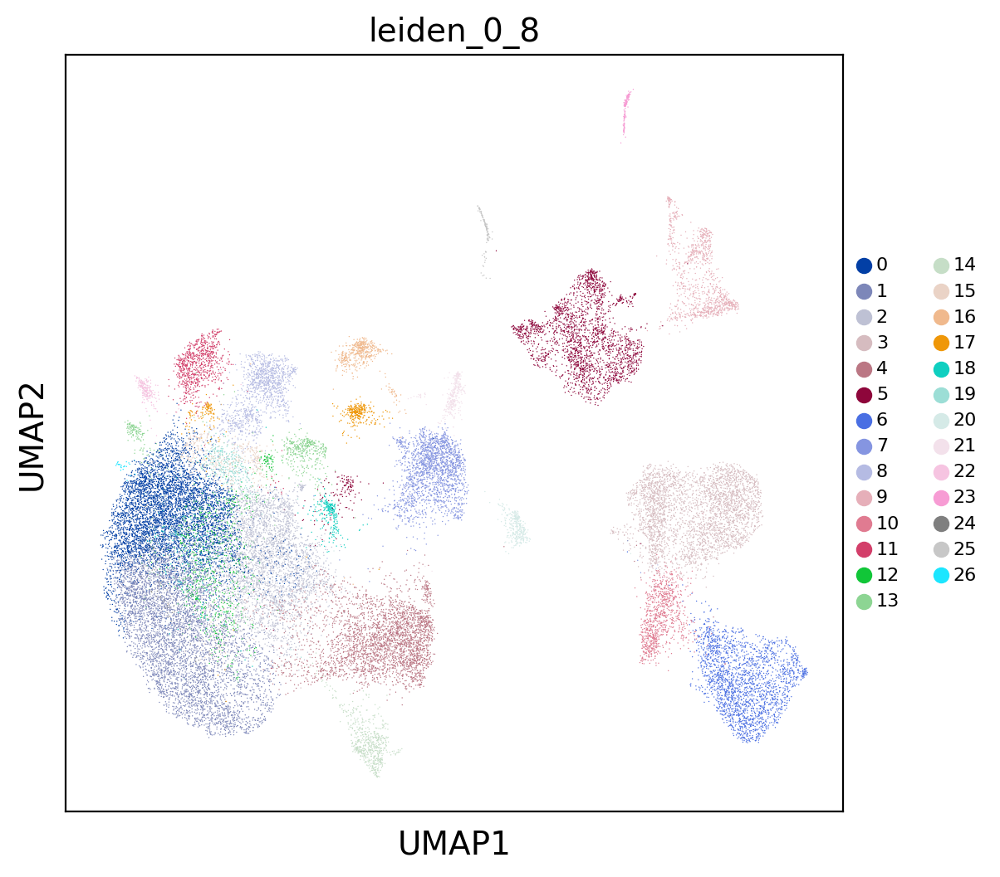

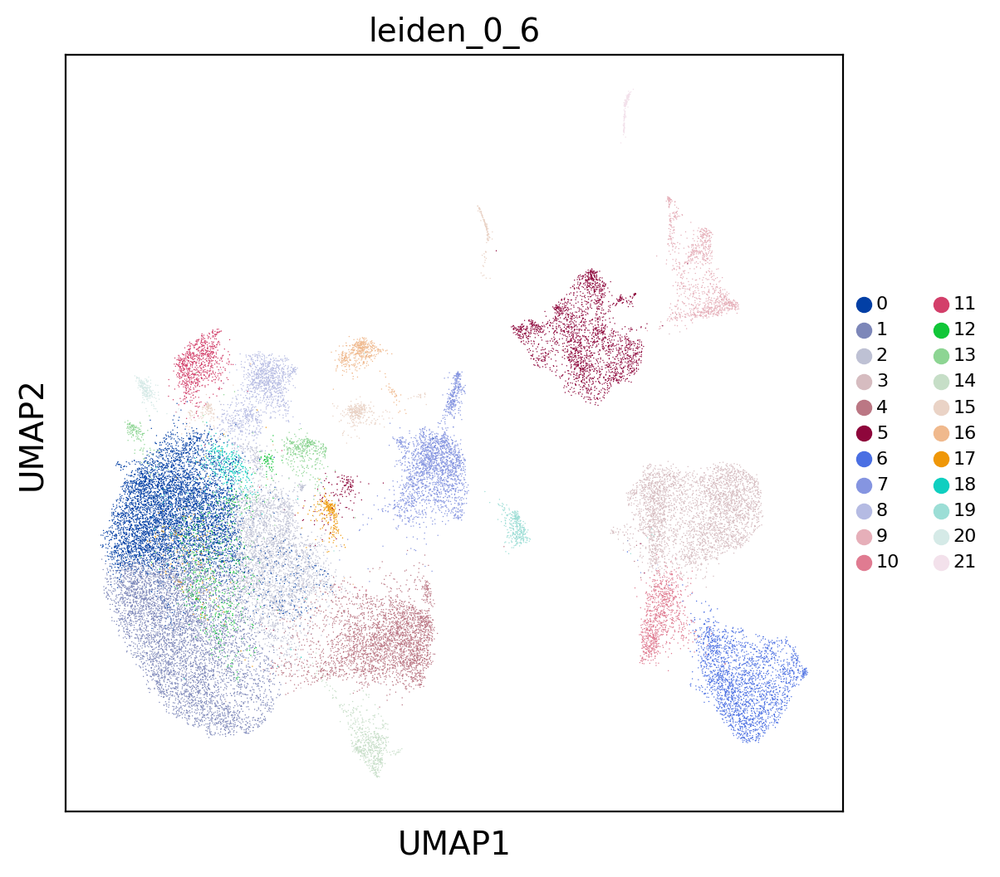

In [111]:
for col in plotting:
    sc.set_figure_params(scanpy=True, dpi=100,figsize=(6,6))
    plt.rcParams['figure.facecolor'] = 'white'
    sc.pl.umap(adata,color=[col],size=1,legend_fontsize=8,legend_fontoutline=2,show=False,cmap='viridis')
    plt.savefig('../../figures/'+output_folder+'/hbreast_1_'+str(col)+'.pdf',bbox_inches='tight')
    plt.show()

# Plotting clusters on the tissue

We now go back to the tissue and plot the clusters back. For this we use the function 'map_of_clusters' to plot clusters on the tissue

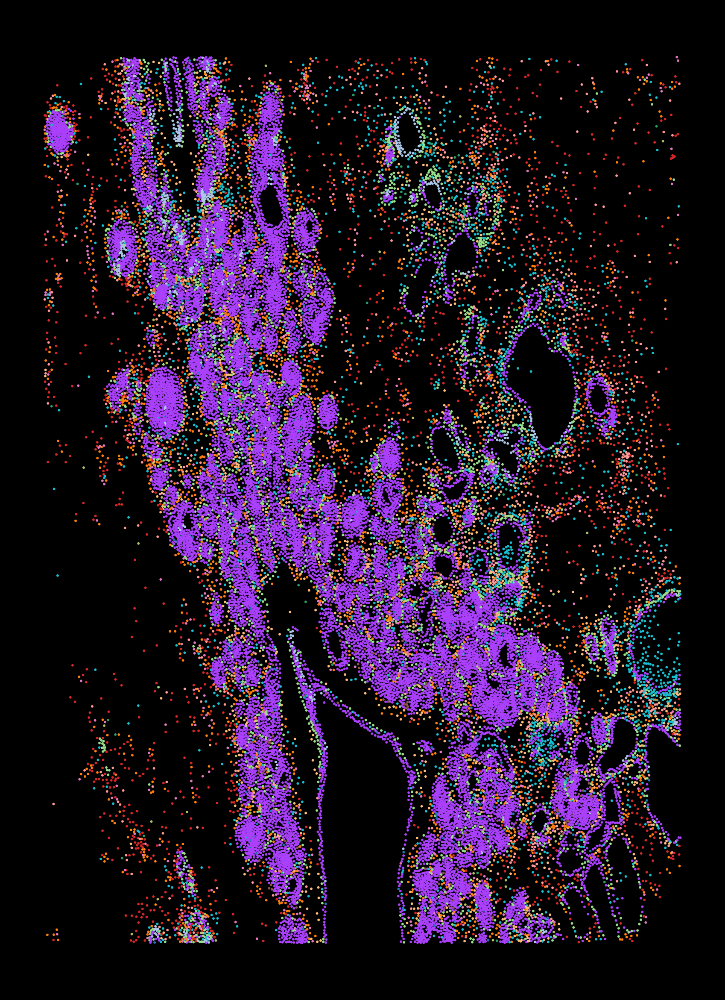

In [109]:
xp.map_of_clusters(adata,key='Class',size=2,background='black',clusters='all',figuresize=(7,10),save='../../figures/'+output_folder,format='jpg')

In [4]:
adata.obs['X_umap']=list(pd.DataFrame(adata.obsm['X_umap'])[0])
adata.obs['Y_umap']=list(pd.DataFrame(-adata.obsm['X_umap'])[1])
adatasub=adata
adatasubobs=adatasub.obs
adatasubobs.to_csv('../../data/celltyping_csv/hbreast_dcis.csv')